# EDSA Movie Recommender System_2301FT-GM4

© Explore Data Science Academy


## Comet Experiement
Comet will be used for version control

<a id="cont"></a>

## Table of Contents
---

<a href=#one>1.Introduction</a>

<a href=#two>2.Importing Packages</a>

<a href=#three>3.Loading Data</a>

<a href=#four>4.Exploratory Data Analysis (EDA)</a>

<a href=#five>5. Data Processing</a>

<a href=#six>6. Modeling</a>

<a href=#seven>7. Model Performance</a>

<a href=#eight>8. Model Explanations</a>

 <a id="one"></a>
## 1. Introduction
<a href=#cont>Back to Table of Contents</a>

### Predict Overview: EA Movie Recommendation
In today's technology-driven world, recommender systems play a crucial role in helping individuals navigate the vast amount of content available to them. These systems are particularly essential in the domain of movie recommendations, where viewers are faced with a multitude of options. Companies like Netflix, Amazon Prime, Showmax, Disney, and others have mastered the art of personalized recommendations, but have you ever wondered how they do it?

### Problem Statement
The challenge at hand is to develop a recommendation algorithm that leverages content or collaborative filtering techniques to accurately predict how a user will rate a movie they have not yet seen based on their historical preferences. The objective is to create a system that can suggest movies that align with a user's tastes and preferences, thereby enhancing their overall viewing experience.

<img src="https://research.aimultiple.com/wp-content/webp-express/webp-images/uploads/2017/08/recommendation-system-800x450.png.webp"
    alt="Dummy image 1"
     style="float: center; padding-bottom=0.5em"
     width=500px/>
### Objectives of the Project
The key objectives of this project are as follow:

* #### Construct a recommendation algorithm
The primary objective is to build an algorithm capable of providing accurate movie recommendations by analyzing user preferences and historical data. This algorithm should leverage either content filtering, which focuses on the attributes and characteristics of the movies, or collaborative filtering, which considers the preferences and behaviors of similar users.
* #### Predict user ratings
The algorithm should be able to predict how a user will rate a movie they have not yet watched. By analyzing patterns and correlations in historical data, it should generate reliable predictions that align with a user's individual taste.
* #### Enhance revenue and platform affinity 
A functional recommender system has immense economic potential. By providing users with accurate and tailored recommendations, it can increase engagement and generate revenue through increased content consumption or purchases. The system should aim to create a strong affinity between users and the platform by consistently delivering relevant and enjoyable movie suggestions.

 <a id="two"></a>
## 2. Importing Packages
<a href=#cont>Back to Table of Contents</a>


In [1]:
# Exploratory Data Analysis
import pickle
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Data Preprocessing
import random
from time import time
import cufflinks as cf
from sklearn.manifold import TSNE
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.ticker import NullFormatter
from sklearn.preprocessing import StandardScaler
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode(connected=True)

# Models
from surprise import Reader, Dataset
from surprise import SVD, NormalPredictor, BaselineOnly, NMF, SlopeOne, CoClustering
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.feature_extraction.text import CountVectorizer

# Performance Evaluation
from surprise import accuracy
from sklearn.metrics import mean_squared_error
from surprise.model_selection import GridSearchCV, cross_validate, train_test_split

# Ignore warnings
import warnings
warnings.simplefilter(action='ignore')

<a id="three"></a>
## 3. Loading the Data
<a class="anchor" id="1.1"></a>
<a href=#cont>Back to Table of Contents</a>


**We start by loading train and test data**

In [2]:
# Read the training data from "train.csv and test.csv" into a DataFrame
train_df = pd.read_csv("train.csv")
test_df = pd.read_csv("test.csv")

# Print the shape of the training and testing DataFrames
print(train_df.shape, test_df.shape)

# Display the first few rows of the training DataFrame
train_df.head()

(10000038, 4) (5000019, 2)


,userId,movieId,rating,timestamp
0,5163,57669,4.0,1518349992
1,106343,5,4.5,1206238739
2,146790,5459,5.0,1076215539
3,106362,32296,2.0,1423042565
4,9041,366,3.0,833375837


In [3]:
# Display the first few rows of the testing DataFrame
test_df.head()

,userId,movieId
0,1,2011
1,1,4144
2,1,5767
3,1,6711
4,1,7318


**Then we load movie dataset**

In [4]:
# Read the movies data from 'movies.csv' and set 'movieId' as the index column
movies_df = pd.read_csv('movies.csv', index_col='movieId')

# Read the IMDb data from 'imdb_data.csv' and set 'movieId' as the index column
imdb_df = pd.read_csv('imdb_data.csv', index_col='movieId')

# Read the links data from 'links.csv' and set 'movieId' as the index column
links_df = pd.read_csv('links.csv', index_col='movieId')

# Read the genome scores data from 'genome_scores.csv' and set 'movieId' as the index column
genome_scores = pd.read_csv('genome_scores.csv', index_col='movieId')

# Read the genome tags data from 'genome_tags.csv' and set 'tagId' as the index column
genome_tags = pd.read_csv('genome_tags.csv', index_col='tagId')

# Read the tags data from 'tags.csv'
tags = pd.read_csv('tags.csv')


# Print the shapes of the DataFrames
print(movies_df.shape, imdb_df.shape, links_df.shape, genome_scores.shape, genome_tags.shape)

(62423, 2) (27278, 5) (62423, 2) (15584448, 2) (1128, 1)


<a id="four"></a>
## 4. Exploratory Data Analysis (EDA)
<a class="anchor" id="1.1"></a>
<a href=#cont>Back to Table of Contents</a>



In [5]:
# Display information about the train_df DataFrame
train_df.info()  

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000038 entries, 0 to 10000037
Data columns (total 4 columns):
 #   Column     Dtype  
---  ------     -----  
 0   userId     int64  
 1   movieId    int64  
 2   rating     float64
 3   timestamp  int64  
dtypes: float64(1), int64(3)
memory usage: 305.2 MB


In [6]:
# Display information about the test_df DataFrame
test_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5000019 entries, 0 to 5000018
Data columns (total 2 columns):
 #   Column   Dtype
---  ------   -----
 0   userId   int64
 1   movieId  int64
dtypes: int64(2)
memory usage: 76.3 MB


In [7]:
# Display information about the movies_df DataFrame
movies_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 62423 entries, 1 to 209171
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   title   62423 non-null  object
 1   genres  62423 non-null  object
dtypes: object(2)
memory usage: 1.4+ MB


In [8]:
# Display information about the imdb_df DataFrame
imdb_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 27278 entries, 1 to 131262
Data columns (total 5 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   title_cast     17210 non-null  object 
 1   director       17404 non-null  object 
 2   runtime        15189 non-null  float64
 3   budget         7906 non-null   object 
 4   plot_keywords  16200 non-null  object 
dtypes: float64(1), object(4)
memory usage: 1.2+ MB


In [9]:
# Display information about the links_df DataFrame
links_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 62423 entries, 1 to 209171
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   imdbId  62423 non-null  int64  
 1   tmdbId  62316 non-null  float64
dtypes: float64(1), int64(1)
memory usage: 1.4 MB


In [10]:
# Display the first few rows of the genome_scores DataFrame
genome_scores.head()

,tagId,relevance
movieId,,
1,1,0.02875
1,2,0.02375
1,3,0.06250
1,4,0.07575
1,5,0.14075


In [11]:
# Display information about the genome_tags DataFrame
genome_tags.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1128 entries, 1 to 1128
Data columns (total 1 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   tag     1128 non-null   object
dtypes: object(1)
memory usage: 17.6+ KB


In [12]:
# Display information about the tags DataFrame
tags.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1093360 entries, 0 to 1093359
Data columns (total 4 columns):
 #   Column     Non-Null Count    Dtype 
---  ------     --------------    ----- 
 0   userId     1093360 non-null  int64 
 1   movieId    1093360 non-null  int64 
 2   tag        1093344 non-null  object
 3   timestamp  1093360 non-null  int64 
dtypes: int64(3), object(1)
memory usage: 33.4+ MB


**The following lines of code print out the number of null values in each DataFrame, providing an overview of missing data:**

In [13]:
print("Train: ")
print(str(train_df.isnull().sum()))
print("*******************************")
print("Test: ")
print(str(test_df.isnull().sum()))
print("*******************************")
print("Movies: ")
print(str(movies_df.isnull().sum()))
print("*******************************")
print("Links: ")
print(str(links_df.isnull().sum()))
print("*******************************")
print("IMDB: ")
print(str(imdb_df.isnull().sum()))
print("*******************************")
print("Genome scores: ")
print(str(genome_scores.isnull().sum()))
print("*******************************")
print("Genome tags: ")
print(str(genome_tags.isnull().sum()))
print("*******************************")
print("Tags: ")
print(str(tags.isnull().sum()))

Train: 
userId       0
movieId      0
rating       0
timestamp    0
dtype: int64
*******************************
Test: 
userId     0
movieId    0
dtype: int64
*******************************
Movies: 
title     0
genres    0
dtype: int64
*******************************
Links: 
imdbId      0
tmdbId    107
dtype: int64
*******************************
IMDB: 
title_cast       10068
director          9874
runtime          12089
budget           19372
plot_keywords    11078
dtype: int64
*******************************
Genome scores: 
tagId        0
relevance    0
dtype: int64
*******************************
Genome tags: 
tag    0
dtype: int64
*******************************
Tags: 
userId        0
movieId       0
tag          16
timestamp     0
dtype: int64


**Dropping missing rows**

In [14]:
# tags_df.dropna(axis=0,inplace=True)
links_df.dropna(axis=0,inplace=True)
tags.dropna(axis=0,inplace=True)

**Checking which users have rated the most movies**

Combined number of ratings:	 38970 
Total number of movies:		 48213


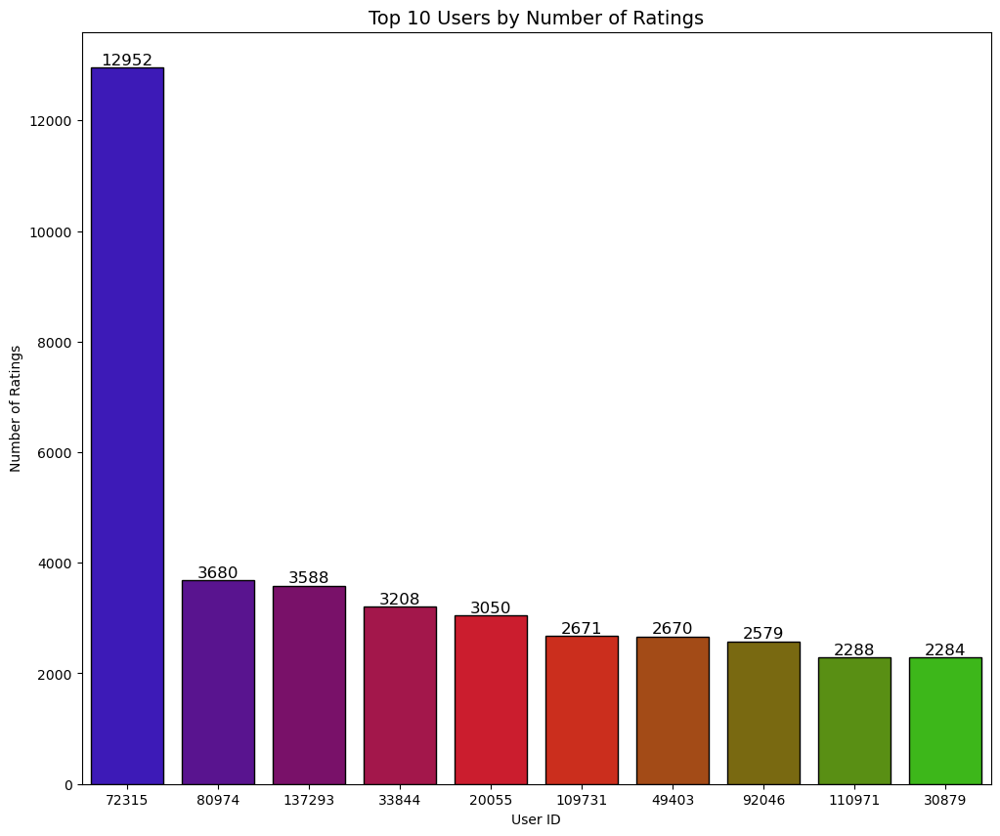

In [15]:
def user_ratings_count(df, n):
    plt.figure(figsize=(12,10))
    data = df['userId'].value_counts().head(n)
    ax = sns.barplot(x = data.index, y = data, order= data.index, palette='brg', edgecolor="black")
    for p in ax.patches:
        ax.text(p.get_x() + p.get_width()/2., p.get_height(), '%d' % int(p.get_height()), fontsize=12, ha='center', va='bottom')
    plt.title(f'Top {n} Users by Number of Ratings', fontsize=14)
    plt.xlabel('User ID')
    plt.ylabel('Number of Ratings')
    print("Combined number of ratings:\t",df['userId'].value_counts().head(n).sum(),
         "\nTotal number of movies:\t\t", df['movieId'].nunique())
    plt.show()

user_ratings_count(train_df,10)

**Observation: User 72315 is considered as outlier or anomalywithin the data frame.**

In [16]:
# How many movies were only rated by our outlier?
movies_lost = 48213 -45844
print(movies_lost, "of movies were rated by an outlier.")   # movies lost from removing the outlier

2369 of movies were rated by an outlier.


Combined number of ratings:	 28296 
Total number of movies:		 45844


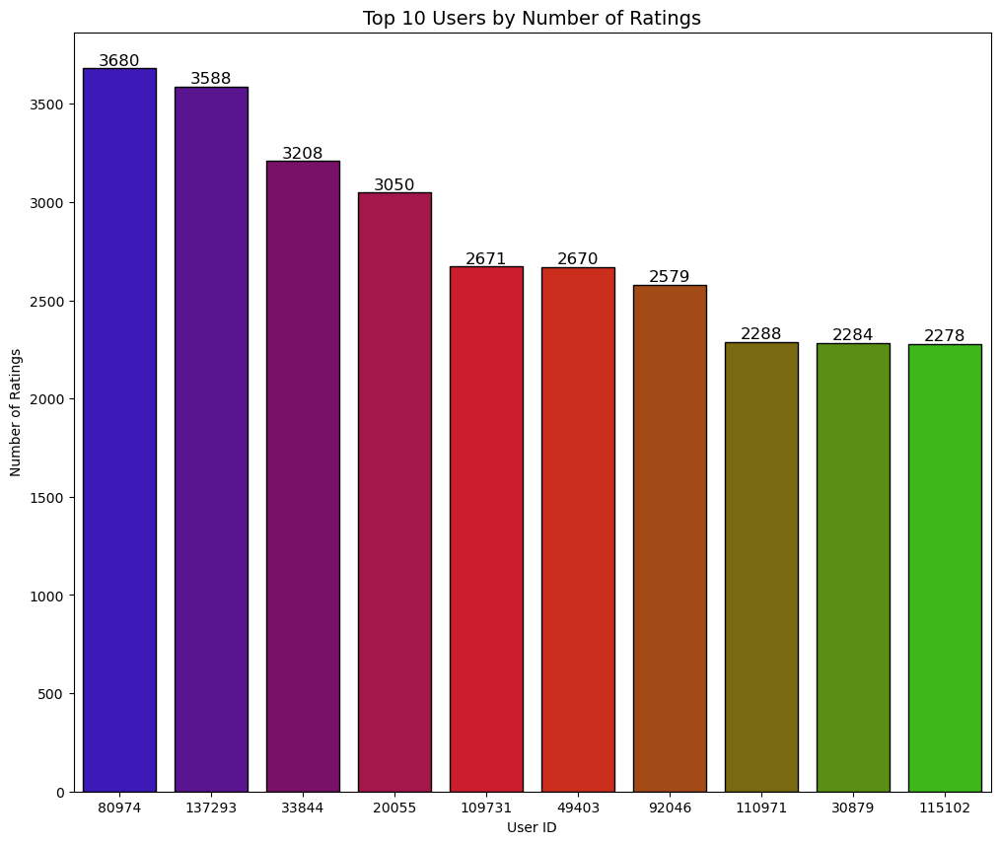

In [17]:
# Remove anomaly and distribution without anomaly
an_df = train_df[train_df['userId']!=72315]
user_ratings_count(an_df,10)

**How do users tend to rate movies?**

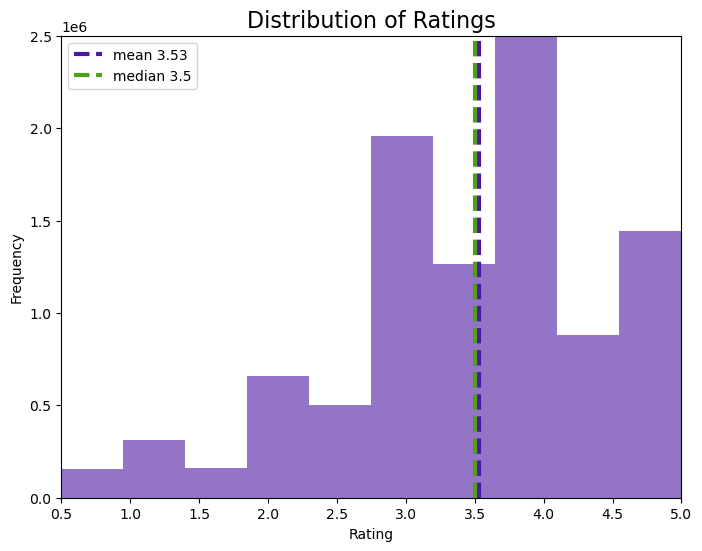

In [18]:
def ratings_distplot(df, column='rating'):
    plt.figure(figsize=(8,6))
    ax = sns.distplot(df[f'{column}'],bins=10, kde=False, hist_kws=dict(alpha=0.6),color="#4D17A0")
    mean = df[f'{column}'].mean()
    median = df[f'{column}'].median()
    plt.axvline(x=mean, label = f'mean {round(mean,2)}' , color='#4D17A0', lw=3, ls = '--')
    plt.axvline(x=median, label = f'median {median}' , color='#4DA017', lw=3, ls = '--')
    plt.xlim((0.5,5))
    plt.ylim((0,2500000))
    plt.title(f'Distribution of Ratings', fontsize=16)
    plt.xlabel('Rating')
    plt.ylabel('Frequency')
    plt.legend()
    plt.show()
    
    
ratings_distplot(an_df)

**Observation:** Our observations reveal an intriguing phenomenon whereby the ratings display a left-skewed distribution. Initially, it was anticipated that the ratings would follow a normal distribution with a mean rating of 3. However, our findings indicate that users generally exhibit a preference for rating movies positively, while demonstrating a reluctance to provide negative ratings. This skew in ratings can be attributed to users' inclination to rate movies they have enjoyed. Stated differently, if a user has a negative opinion of a movie, it is improbable that they will watch it in its entirety, let alone engage in rating it.

---

**Relationship between the number of ratings a movie has and how highly it is rated**

In [19]:
def mean_ratings_scatter(df, color='#4DA017', column='userId'):
    plt.figure(figsize=(6,4))
    mean_ratings = df.groupby(f'{column}')['rating'].mean()
    user_counts = df.groupby(f'{column}')['movieId'].count().values
    sns.scatterplot(x=mean_ratings, y = user_counts, color=color)
    plt.title(f'Mean Ratings by Number of Ratings', fontsize=14)
    plt.xlabel('Rating')Qs:Here we check if there is a relationship between the number of movies a user has rated and the rating that they give?
    plt.ylabel('Number of Ratings')
    plt.show()

Object `give` not found.


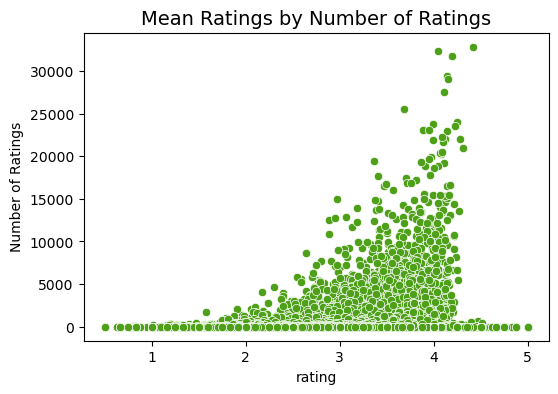

In [20]:
# Mean movie ratings by number of ratings
mean_ratings_scatter(an_df, column='movieId')

**The best and worst rated movies of all time**

In [21]:
# Creating a new DF with mean and count

def plot_ratings(count, n, color='#4DA017', best=True, method='mean'):
   
    if method == 'mean':
        movie_avg_ratings = pd.DataFrame(an_df.join(movies_df, on='movieId', how='left').groupby(['movieId', 'title'])['rating'].mean())
    else:
        movie_avg_ratings = pd.DataFrame(an_df.join(movies_df, on='movieId', how='left').groupby(['movieId', 'title'])['rating'].median())
    movie_avg_ratings['count'] = an_df.groupby('movieId')['userId'].count().values
    movie_avg_ratings.reset_index(inplace=True)
    movie_avg_ratings.set_index('movieId', inplace=True)

    # Remove movies that have been rated fewer than n times
    data = movie_avg_ratings[movie_avg_ratings['count']>count]
    data.sort_values('rating', inplace= True,ascending=False)
    if best == True:
        plot = data.head(n).sort_values('rating', ascending=True)
        title='Best Rated'
    else:
        plot = data.tail(n).sort_values('rating', ascending=False)
        title='Worst Rated'
    plt.figure(figsize=(9,5))
    sns.scatterplot(x=plot['rating'], y=plot['title'], size=plot['count'], color=color)
    plt.xlabel('Rating')
    plt.ylabel('')
    plt.tick_params(axis='y', which='both', labelleft=False, labelright=True)
    plt.title(f'Top {n} {title} Movies with Over {count} Ratings', fontsize=20)
    plt.show()

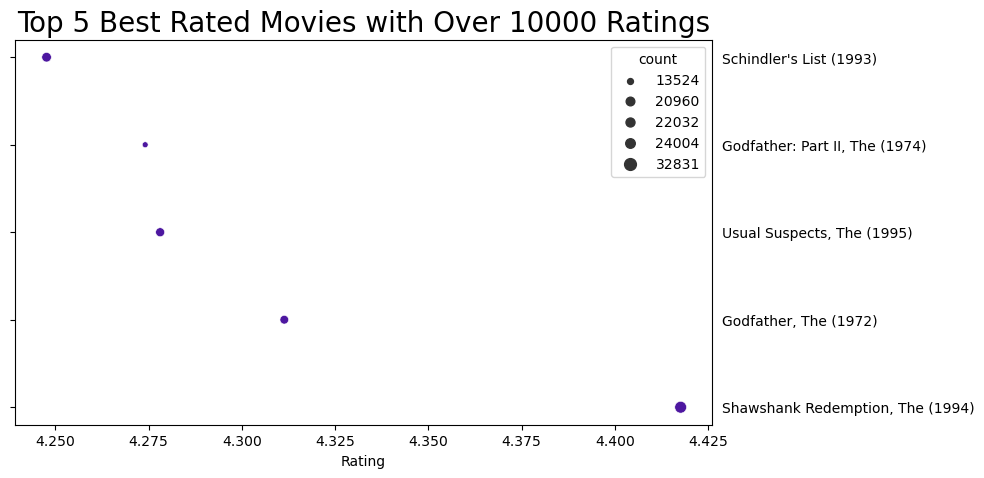

In [22]:
# Top five of highest rated titles
plot_ratings(10000, 5, '#4D17A0', True, 'mean')

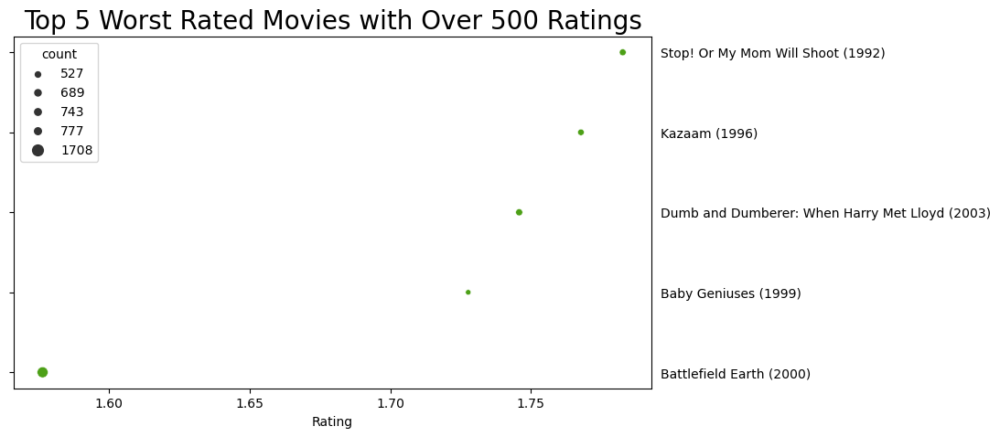

In [23]:
# Top 5 of worst rated titles
plot_ratings(500, 5,'#4DA017', False, 'mean')

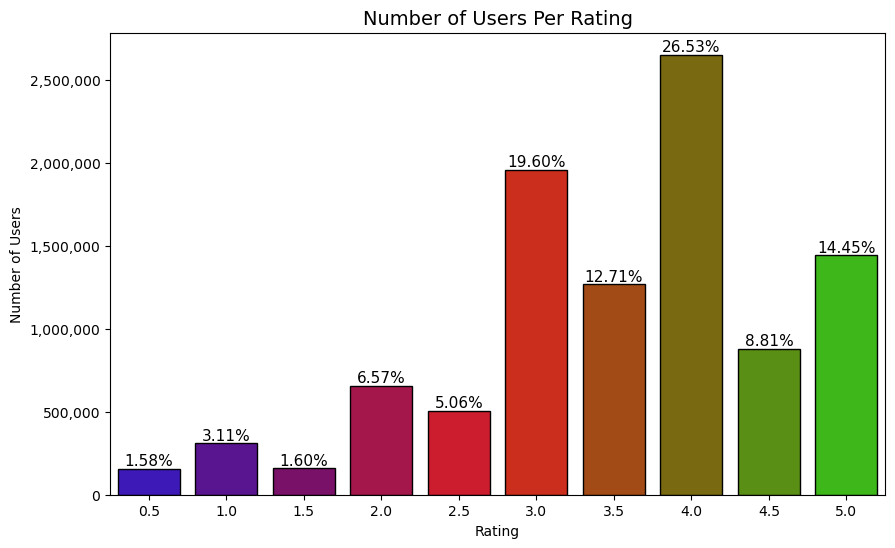

In [24]:
#Percentage of users per rating

movieRatingDistGroup = train_df['rating'].value_counts().sort_index().reset_index()
fig, ax = plt.subplots(figsize=(10,6))
sns.barplot(data=movieRatingDistGroup, x='index', y='rating', palette="brg", edgecolor="black", ax=ax)
ax.set_xlabel("Rating")
ax.set_ylabel('Number of Users')
ax.set_yticklabels(['{:,}'.format(int(x)) for x in ax.get_yticks().tolist()])
total = float(movieRatingDistGroup['rating'].sum())
for p in ax.patches:
    height = p.get_height()
    ax.text(p.get_x()+p.get_width()/2., height+350, '{0:.2%}'.format(height/total), fontsize=11, ha="center", va='bottom')
plt.title('Number of Users Per Rating', fontsize=14)
plt.show()

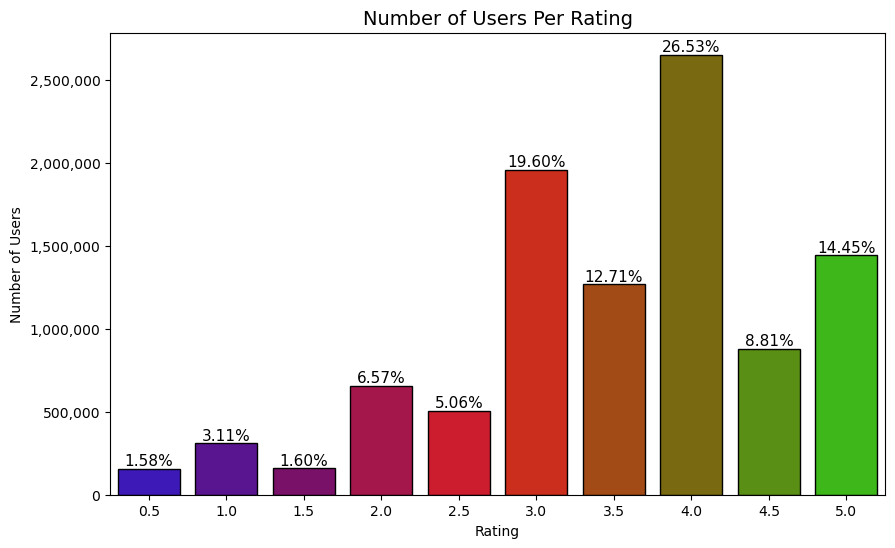

In [25]:
#Percentage of users per rating

movieRatingDistGroup = train_df['rating'].value_counts().sort_index().reset_index()
fig, ax = plt.subplots(figsize=(10,6))
sns.barplot(data=movieRatingDistGroup, x='index', y='rating', palette="brg", edgecolor="black", ax=ax)
ax.set_xlabel("Rating")
ax.set_ylabel('Number of Users')
ax.set_yticklabels(['{:,}'.format(int(x)) for x in ax.get_yticks().tolist()])
total = float(movieRatingDistGroup['rating'].sum())
for p in ax.patches:
    height = p.get_height()
    ax.text(p.get_x()+p.get_width()/2., height+350, '{0:.2%}'.format(height/total), fontsize=11, ha="center", va='bottom')
plt.title('Number of Users Per Rating', fontsize=14)
plt.show()

In [26]:
def feature_frequency(df, column):
    # Creat a dict to store values
    df = df.dropna(axis=0)
    genre_dict = {f'{column}': list(),
                 'count': list(),}
    # Retrieve a list of all possible genres
    print('retrieving features...')
    for movie in range(len(df)):
        gens = df[f'{column}'].iloc[movie].split('|')
        for gen in gens:
            if gen not in genre_dict[f'{column}']:
                genre_dict[f'{column}'].append(gen)
    # count the number of occurences of each genre
    print('counting...')
    for genre in genre_dict[f'{column}']:
        count = 0
        for movie in range(len(df)):
            gens = df[f'{column}'].iloc[movie].split('|')
            if genre in gens:
                count += 1
        genre_dict['count'].append(count)
        
        # Calculate metrics
    data = pd.DataFrame(genre_dict)
    print('done!')
    return data
genres = feature_frequency(movies_df, 'genres')

retrieving features...
counting...
done!


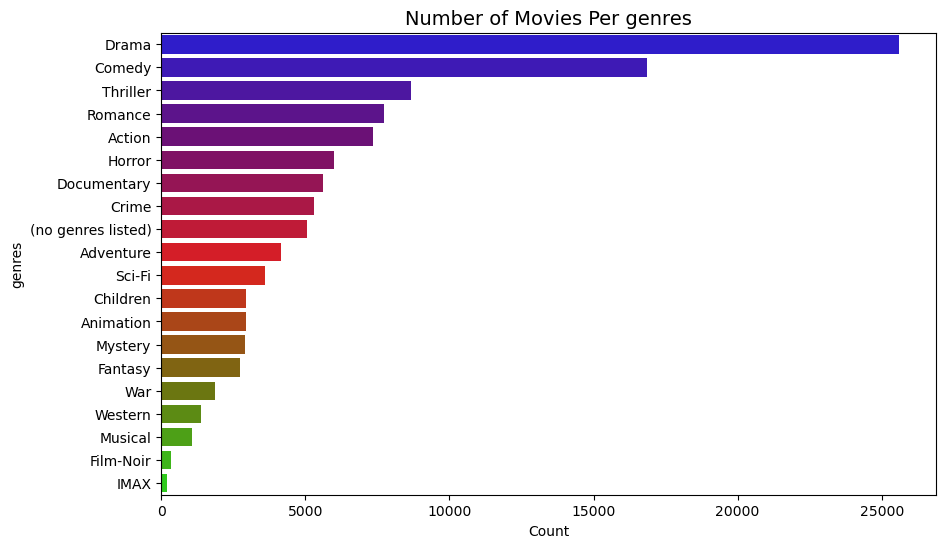

In [27]:
def feature_count(df, column):
    plt.figure(figsize=(10,6))
    ax = sns.barplot(y = df[f'{column}'], x = df['count'], palette='brg', orient='h')
    plt.title(f'Number of Movies Per {column}', fontsize=14)
    plt.ylabel(f'{column}')
    plt.xlabel('Count')
    plt.show()

feature_count(genres.sort_values(by = 'count', ascending=False), 'genres')

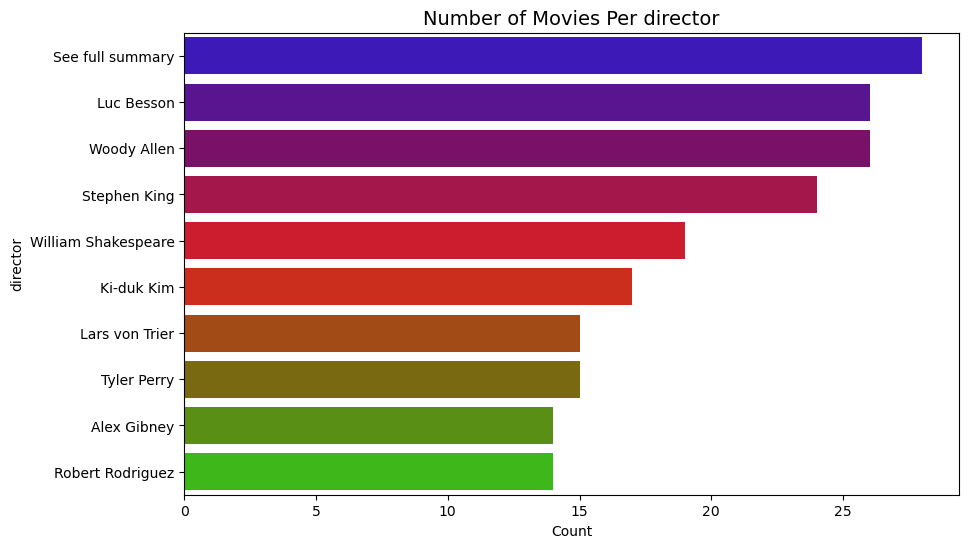

In [28]:
# The most common directors
def count_directors(df, count = 10):
    directors = pd.DataFrame(df['director'].value_counts()).reset_index()
    directors.columns = ['director', 'count']
    # Lets only take directors who have made 10 or more movies otherwise we will have to analyze 11000 directors
    directors = directors[directors['count']>=count]
    return directors.sort_values('count', ascending = False)
directors = count_directors(imdb_df)
feature_count(directors.head(10), 'director')

<a id="five"></a>
## 5. Data Processing
<a class="anchor" id="1.1"></a>
<a href=#cont>Back to Table of Contents</a>


In [29]:
# Subset the data to cut down computation time for now
genome_score = genome_scores[:10000000]

In [30]:
# Although scores are in the range of 0-1, there is no harm in scaling
scaler_mds = StandardScaler()
mds_genome = scaler_mds.fit_transform(genome_score.sample(frac=0.0001))

In [31]:
tsne = TSNE(3, n_jobs = -1, verbose = 2, perplexity = 10, learning_rate = 0.1)

In [32]:
tsne.fit(mds_genome)

[t-SNE] Computing 31 nearest neighbors...
[t-SNE] Indexed 1000 samples in 0.008s...
[t-SNE] Computed neighbors for 1000 samples in 0.036s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1000
[t-SNE] Mean sigma: 0.069195
[t-SNE] Computed conditional probabilities in 0.032s
[t-SNE] Iteration 50: error = 84.5837631, gradient norm = 0.0000243 (50 iterations in 0.574s)
[t-SNE] Iteration 100: error = 84.5837631, gradient norm = 0.0000040 (50 iterations in 0.538s)
[t-SNE] Iteration 150: error = 84.5837631, gradient norm = 0.0000050 (50 iterations in 0.455s)
[t-SNE] Iteration 200: error = 84.5837631, gradient norm = 0.0000105 (50 iterations in 0.486s)
[t-SNE] Iteration 250: error = 84.5837631, gradient norm = 0.0000291 (50 iterations in 0.433s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 84.583763
[t-SNE] Iteration 300: error = 4.5637474, gradient norm = 0.0000485 (50 iterations in 0.466s)
[t-SNE] Iteration 350: error = 4.5637450, gradient norm = 0.00013

TSNE(learning_rate=0.1, n_components=3, n_jobs=-1, perplexity=10, verbose=2)

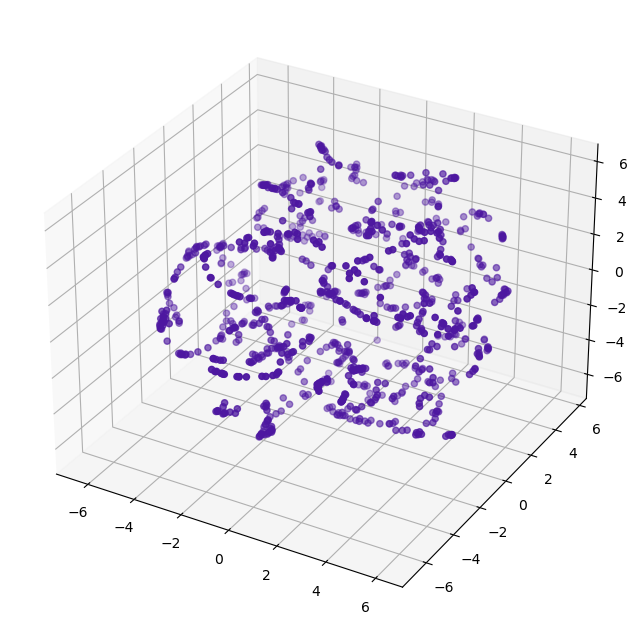

In [33]:
Axes3D

fig = plt.figure(figsize=(15, 8))

# Add 3D scatter plot
ax = fig.add_subplot(projection='3d')
ax.scatter(tsne.embedding_[:,0], tsne.embedding_[:,1], tsne.embedding_[:,2], color='#4D17A0')
plt.show()

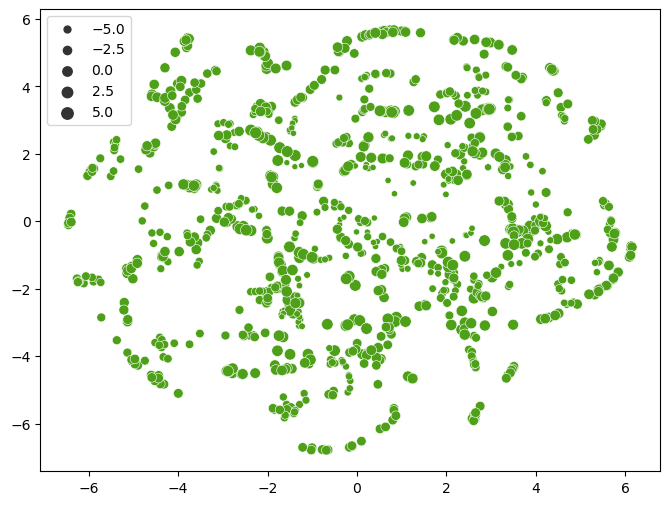

In [34]:
fig = plt.figure(figsize=(8, 6))
sns.scatterplot(x = tsne.embedding_[:,0], y = tsne.embedding_[:,1], size=tsne.embedding_[:,2],color='#4DA017')
plt.show()

### Principal Component Analysis

In [35]:
# Manually pivot table as data is too large for in-built functions
def pivot_(df):
    new_dict = {'movieId':sorted(set(df.index))}
    pivoted = pd.DataFrame(new_dict)
    tagids = sorted(set(df['tagId']))
    for Id in range(len(tagids)):
        pivoted[f'{Id+1}'] = list(df[df['tagId'] == Id+1]['relevance'])
    return pivoted

In [36]:
pca_data_pivoted = pivot_(genome_scores).set_index('movieId')
pca_data_pivoted.shape

(13816, 1128)

In [37]:
pca_data_pivoted.columns = list(genome_tags['tag'])

In [38]:
pca_data_pivoted.head()

,007,007 (series),18th century,1920s,1930s,1950s,1960s,1970s,1980s,19th century,...,world politics,world war i,world war ii,writer's life,writers,writing,wuxia,wwii,zombie,zombies
movieId,,,,,,,,,,,,,,,,,,,,,
1,0.02875,0.02375,0.06250,0.07575,0.14075,0.14675,0.06350,0.20375,0.2020,0.03075,...,0.04050,0.01425,0.03050,0.03500,0.14125,0.05775,0.03900,0.02975,0.08475,0.02200
2,0.04125,0.04050,0.06275,0.08275,0.09100,0.06125,0.06925,0.09600,0.0765,0.05250,...,0.05250,0.01575,0.01250,0.02000,0.12225,0.03275,0.02100,0.01100,0.10525,0.01975
3,0.04675,0.05550,0.02925,0.08700,0.04750,0.04775,0.04600,0.14275,0.0285,0.03875,...,0.06275,0.01950,0.02225,0.02300,0.12200,0.03475,0.01700,0.01800,0.09100,0.01775
4,0.03425,0.03800,0.04050,0.03100,0.06500,0.03575,0.02900,0.08650,0.0320,0.03150,...,0.05325,0.02800,0.01675,0.03875,0.18200,0.07050,0.01625,0.01425,0.08850,0.01500
5,0.04300,0.05325,0.03800,0.04100,0.05400,0.06725,0.02775,0.07650,0.0215,0.02975,...,0.05350,0.02050,0.01425,0.02550,0.19225,0.02675,0.01625,0.01300,0.08700,0.01600


In [39]:
features = [col for col in pca_data_pivoted.columns]

In [40]:
cf.set_config_file(offline=True, world_readable=True, theme='white')
columns = random.sample(range(0, 1129), 20)
pca_data_pivoted.iloc[:,columns].iplot(kind='box', title="Boxplots of Features (Unscaled)")

In [41]:
def scaler(df):
    scaler = StandardScaler(with_std=True)
    scaled_data = scaler.fit_transform(df)
    return scaled_data

In [42]:
pca_scaled = scaler(pca_data_pivoted)
scaled_pca = pd.DataFrame(pca_scaled, index = pca_data_pivoted.index, columns = pca_data_pivoted.columns)

In [43]:
cf.set_config_file(offline=True, world_readable=True, theme='white')
# using plotly to plot the boxplot
scaled_pca.iloc[:,columns].iplot(kind='box', title="Boxplots of Features (Scaled)")

Text(0, 0.5, 'Cumulative explained variance')

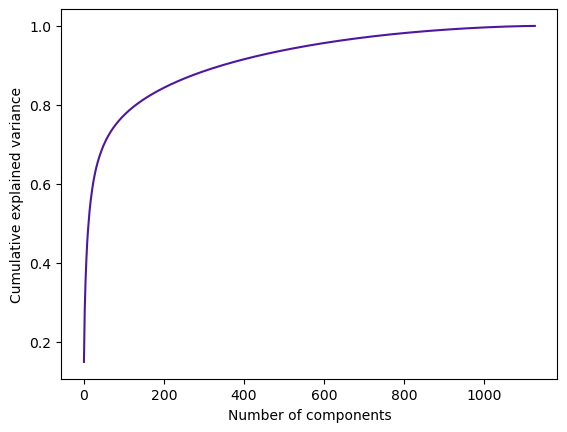

In [44]:
# define PCA object
pca = PCA()

# fit the PCA model to our data and apply the dimensionality reduction 
prin_comp = pca.fit_transform(pca_data_pivoted[features])

# create a dataframe containing the principal components
pca_df = pd.DataFrame(data = prin_comp,
                      index=pca_data_pivoted.index, columns=pca_data_pivoted.columns
                     )

# plot line graph of cumulative variance explained
plt.plot(np.cumsum(pca.explained_variance_ratio_),color='#4D17A0')
plt.xlabel('Number of components')
plt.ylabel('Cumulative explained variance')

In [45]:
pca_75 = PCA(.80)
pca_75_df = pca_75.fit_transform(pca_data_pivoted)
print(round(pca_75.explained_variance_ratio_.sum()*100, 1),
      "% of variance explained by",
      pca_75.n_components_,
      "components.")

80.0 % of variance explained by 131 components.


**Observation:** The cumulative explained variance plot displays a distinct shape, deviating from the expected sharp elbow. This deviation is likely a consequence of the genomes already being chosen as the primary components of the movies. However, it is noteworthy that 131 components effectively capture 80% of the variance present in the movie dataset. To optimize computational efficiency, it is recommended to solely utilize these 131 components in a content-based mode.

In [46]:
pca_75_df = pd.DataFrame(pca_75_df, index = pca_data_pivoted.index)
pca_75_df.head()

,0,1,2,3,4,5,6,7,8,9,...,121,122,123,124,125,126,127,128,129,130
movieId,,,,,,,,,,,,,,,,,,,,,
1,0.796514,2.212839,-2.489444,1.624747,0.984763,1.168046,-0.203300,1.659382,-0.675962,-1.251265,...,-0.166531,0.023522,0.124865,0.091553,-0.014734,-0.082235,0.029796,-0.077556,-0.072878,-0.094931
2,-1.541922,1.597864,-1.113613,1.302526,-0.196336,0.191809,-0.026161,1.208987,-0.369388,-0.483199,...,0.026369,-0.088038,0.113610,-0.050569,-0.015265,0.067904,0.026488,0.013665,0.079228,-0.130822
3,-1.506092,-0.010220,-0.605981,-0.316252,0.330972,0.334078,0.048253,0.010072,-0.042318,0.040345,...,0.060794,-0.101178,0.033077,0.073228,-0.010904,-0.094919,0.019864,0.004834,0.059739,0.035608
4,-1.293604,-0.775662,-0.926582,-0.384600,0.103713,-0.345682,0.683775,0.218370,-0.159426,0.639183,...,-0.036119,-0.145511,0.102927,-0.103027,0.005975,0.053953,0.044405,-0.202070,-0.158430,0.007054
5,-1.694557,-0.185986,-1.204239,-0.149549,0.470713,0.053199,0.385026,0.302557,-0.133082,-0.083749,...,0.016023,0.069098,-0.017486,0.005937,0.127657,-0.019529,-0.327449,-0.137680,-0.053703,0.065995


### Cluster Analysis

In [47]:
# Manually implement the WCSS
def within_cluster_variation(df, label_col='cluster_label'):
  
    centroids = df.groupby(label_col).mean()
    out = 0
    for label, point in centroids.iterrows():
        df_features = df[df[label_col] == label].drop(label_col, axis=1)
        out += (df_features - point).pow(2).sum(axis=1).sum()
    return out

In [48]:
# let's try everything between 2 and 18 clusters where 18 is the number of genres
n_clusters = np.arange(2, 19)

# store errors for each value of k
errors = []

# for i between 2 and 19
for k in n_clusters:
    print(f'training model with {k} clusters')
    # perform k-means clustering
    km = KMeans(n_clusters=k, n_init=10, max_iter=300, random_state=42)
    km.fit(pca_75_df)
    
    # measure BCSS
    print(f'evaluating model with {k} clusters')
    y_preds = km.predict(pca_75_df)
    pca_75_df = pd.DataFrame(pca_75_df)
    pca_75_df['cluster_label'] = y_preds
    errors.append(within_cluster_variation(pca_75_df, 'cluster_label'))
    print(errors[-1])

training model with 2 clusters
evaluating model with 2 clusters
167610.09951547848
training model with 3 clusters
evaluating model with 3 clusters
159202.04716452214
training model with 4 clusters
evaluating model with 4 clusters
153979.41324329143
training model with 5 clusters
evaluating model with 5 clusters
149074.88861234672
training model with 6 clusters
evaluating model with 6 clusters
145054.80661973805
training model with 7 clusters
evaluating model with 7 clusters
141701.3376691966
training model with 8 clusters
evaluating model with 8 clusters
139251.25169642275
training model with 9 clusters
evaluating model with 9 clusters
137033.02607491956
training model with 10 clusters
evaluating model with 10 clusters
135148.42670872988
training model with 11 clusters
evaluating model with 11 clusters
132591.0326160025
training model with 12 clusters
evaluating model with 12 clusters
130792.51569023248
training model with 13 clusters
evaluating model with 13 clusters
129498.1890617720

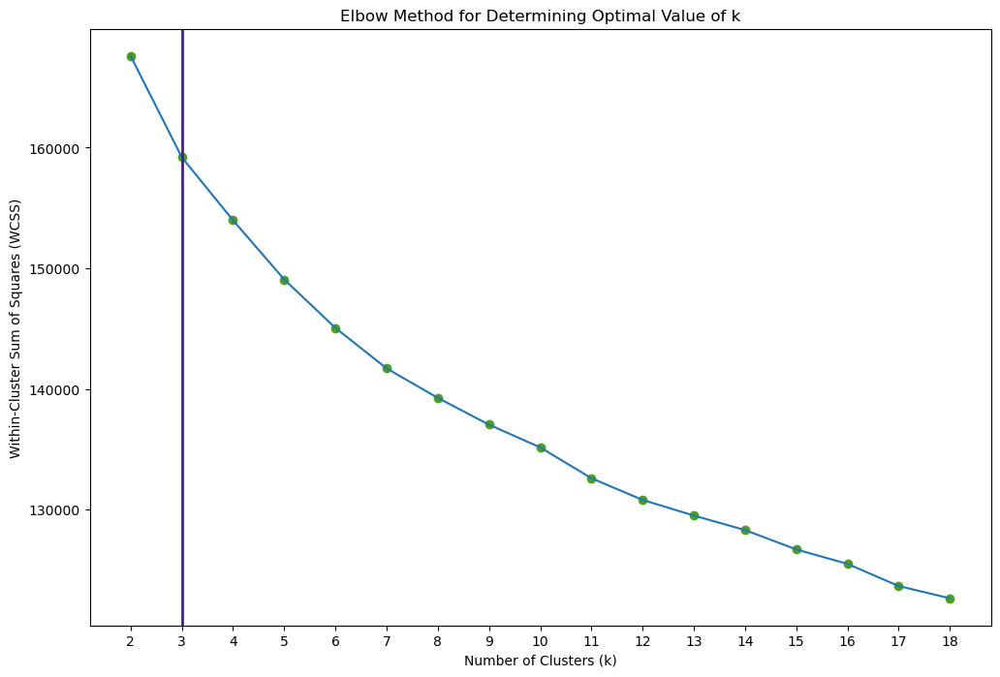

In [49]:
plt.figure(figsize=(12,8))
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Within-Cluster Sum of Squares (WCSS)')
plt.title('Elbow Method for Determining Optimal Value of k')
plt.scatter(n_clusters, errors, color="#4DA017")
plt.plot(n_clusters, errors)
plt.xticks(n_clusters)
plt.axvline(x=3, color='#4D17A0', lw=2)
plt.show()

In [50]:
K = 3
# Remember to set the random state for reproducibility
km = KMeans(n_clusters=K, verbose=0, random_state=42)
print("Clustering sparse data with %s" % km)
t0 = time()
km.fit(pca_75_df)
print("done in %0.3fs" % (time() - t0))

Clustering sparse data with KMeans(n_clusters=3, random_state=42)
done in 0.259s


In [51]:
# Obtain cluster memberships for each item in the data
y_preds = km.predict(pca_75_df)
pca_75_df['cluster_label'] = y_preds
centers = km.cluster_centers_

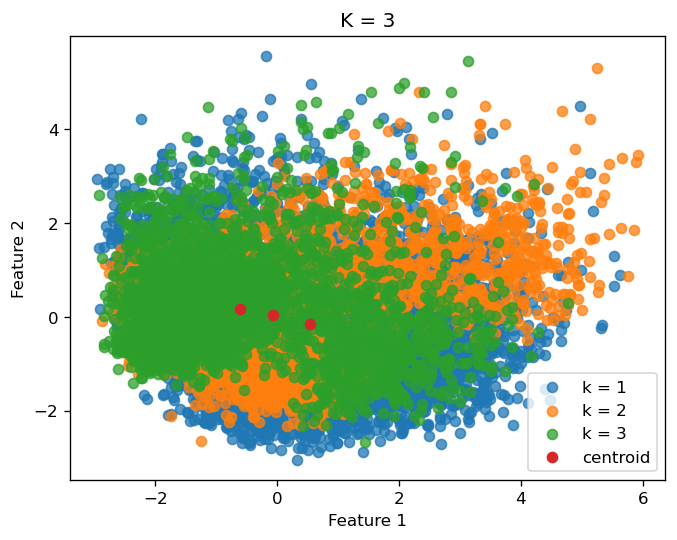

In [52]:
plt.figure(dpi=120)
for k in range(K):
    x1 = pca_75_df[pca_75_df['cluster_label'] == k][0]
    x2 = pca_75_df[pca_75_df['cluster_label'] == k][1]
    plt.scatter(x1, x2, label="k = "+str(k+1),alpha=0.75)
# Show cluster centroid locations    
plt.scatter(centers[:,0],centers[:,1],label="centroid")
plt.legend()
plt.title(f"K = {K}")
plt.xlabel('Feature 1')
plt.ylabel('Feature 2')
plt.show()

<a id="six"></a>
## 6. Modelling
<a class="anchor" id="1.1"></a>
<a href=#cont>Back to Table of Contents</a>


In order to minimize computational time, we employ a training and evaluation approach on a subset of 100k data points for the following models. The model that demonstrates superior performance will subsequently be trained on the entire dataset to predict ratings for the final submission file.

In [53]:
# Load the 100k dataset
train_df.drop('timestamp', axis=1, inplace=True)
train_subset = train_df[:100000]
reader = Reader(rating_scale=(train_subset['rating'].min(), train_subset['rating'].max()))
data = Dataset.load_from_df(train_subset[['userId', 'movieId', 'rating']], reader)
trainset, testset = train_test_split(data, test_size=.25, random_state=42)

### The following model were trained and evaluated based on collaborative filtering:
- Singular Value Decomposition (SVD)
- Baseline Only (BLO)
- Non-negative Matrix Factorization (nmf)
    

### SVD

The Singular Value Decomposition (SVD) algorithm is a mathematical method used to break down a matrix into three separate matrices: U, Σ, and V. It allows for the extraction of essential patterns and features from the original matrix. The U and V matrices capture relationships within the rows and columns of the matrix, respectively, while the Σ matrix holds the singular values that represent the significance of each pattern. 

In [54]:
svd_test = SVD(n_epochs = 50, n_factors = 200, init_std_dev = 0.05, random_state=42)
svd_test.fit(trainset)
predictions = svd_test.test(testset)
# Calculate RMSE
svd_rmse = accuracy.rmse(predictions)

RMSE: 0.9739


### BaselineOnly

The BaselineOnly algorithm is a collaborative filtering approach used in recommender systems. It calculates baseline estimates for user-item pairs based on average ratings, capturing overall user tendencies and item popularity. By incorporating deviations from these baselines, it predicts ratings for unseen user-item pairs. The algorithm serves as a reliable baseline, and it can be used independently or in conjunction with other collaborative filtering methods to enhance recommendation accuracy.

In [55]:
bsl_options = {'method': 'sgd','n_epochs': 40}
blo_test = BaselineOnly(bsl_options=bsl_options)
blo_test.fit(trainset)
predictions = blo_test.test(testset)
# Calculate RMSE
blo_rmse = accuracy.rmse(predictions)

Estimating biases using sgd...
RMSE: 0.9735


### Non-negative Matrix Factorization.

Non-negative Matrix Factorization (NMF) is an unsupervised machine learning technique that decomposes a non-negative data matrix into two non-negative matrices, revealing latent patterns and structures in the data. It is widely used for tasks such as clustering, dimensionality reduction, and anomaly detection, providing valuable insights without the need for explicit labels or target variables.






In [56]:
nmf_test = NMF()
nmf_test.fit(trainset)
predictions = nmf_test.test(testset)
# Calculate RMSE
nmf_rmse = accuracy.rmse(predictions)

RMSE: 1.1639


<a id="seven"></a>
## 7. Model Performance
<a class="anchor" id="1.1"></a>
<a href=#cont>Back to Table of Contents</a>


We developed and evaluated three distinct collaborative filtering models, employing the root mean squared error (RMSE) as a statistical metric to gauge their performance. The RMSE quantifies the average squared deviation between the predicted and actual values, serving as an indicator of model accuracy. By conducting this comparison, we aimed to identify the model or models with lower RMSE values, signifying higher accuracy in predicting user preferences or ratings.

### Root Mean Squared Error (RMSE):
$$RMSE = \sqrt{\frac{1}{n}\Sigma_{i=1}^{n}{\Big(\frac{d_i -f_i}{\sigma_i}\Big)^2}}$$   

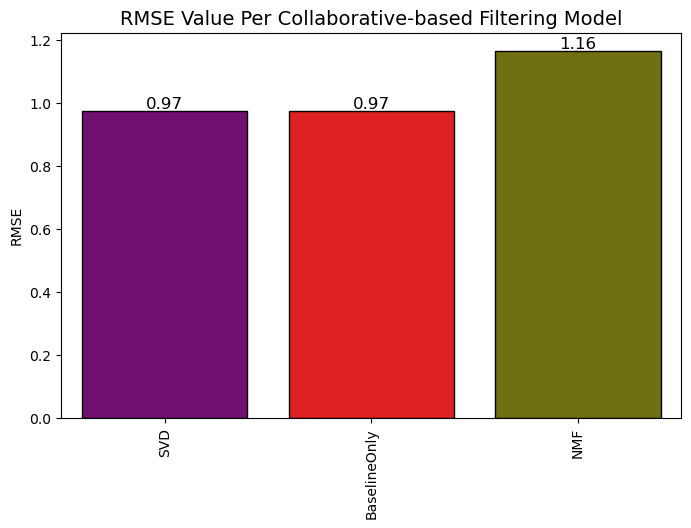

In [57]:
# Compare RMSE values between models
fig,axis = plt.subplots(figsize=(8, 5))
rmse_x = ['SVD','BaselineOnly','NMF']
rmse_y = [svd_rmse,blo_rmse,nmf_rmse]
ax = sns.barplot(x=rmse_x, y=rmse_y,palette='brg',edgecolor='black')
plt.title('RMSE Value Per Collaborative-based Filtering Model',fontsize=14)
plt.xticks(rotation=90)
plt.ylabel('RMSE')
for p in ax.patches:
    ax.text(p.get_x() + p.get_width()/2, p.get_y() + p.get_height(), round(p.get_height(),2), fontsize=12, ha="center", va='bottom')
    
plt.show()

### Cross Validation

Cross-validation is a fundamental technique employed to assess the predictive accuracy of a model on unseen data or validation sets. Its purpose is to detect potential problems like overfitting, underfitting, and selection bias. In our study, we applied the K-fold cross-validation technique to rigorously evaluate the performance of our top-performing models, specifically SVD and BaselineOnly. By partitioning the data into K subsets and iteratively training and validating the models, we obtained robust estimations of their predictive capabilities and gained insights into their generalization abilities.

#### SVD

In [58]:
svd_test = SVD(n_epochs = 30, n_factors = 200, init_std_dev = 0.05, random_state=42)
# Run 5-fold cross-validation and print results
a = cross_validate(svd_test, data, measures=['RMSE'], cv=5, verbose=True)

Evaluating RMSE of algorithm SVD on 5 split(s).

                  Fold 1  Fold 2  Fold 3  Fold 4  Fold 5  Mean    Std     
RMSE (testset)    0.9753  0.9694  0.9698  0.9726  0.9612  0.9697  0.0047  
Fit time          2.53    2.52    2.29    3.35    2.09    2.55    0.43    
Test time         0.09    0.26    0.13    0.11    0.30    0.18    0.09    


#### BaselineOnly

In [59]:
bsl_options = {'method': 'sgd','n_epochs': 30}
blo_test = BaselineOnly(bsl_options=bsl_options)
# Run 5-fold cross-validation and print results
b = cross_validate(blo_test, data, measures=['RMSE'], cv=5, verbose=True)

Estimating biases using sgd...
Estimating biases using sgd...
Estimating biases using sgd...
Estimating biases using sgd...
Estimating biases using sgd...
Evaluating RMSE of algorithm BaselineOnly on 5 split(s).

                  Fold 1  Fold 2  Fold 3  Fold 4  Fold 5  Mean    Std     
RMSE (testset)    0.9731  0.9634  0.9740  0.9622  0.9704  0.9686  0.0049  
Fit time          0.87    0.95    1.08    0.68    0.79    0.87    0.13    
Test time         0.13    0.10    0.12    0.07    0.20    0.12    0.04    


## Submission

### SVD

In [61]:
# Train model on whole dataset
reader = Reader(rating_scale=(train_df['rating'].min(), train_df['rating'].max()))
data = Dataset.load_from_df(train_df[['userId', 'movieId', 'rating']], reader)
trainset = data.build_full_trainset()
svd = SVD(n_epochs = 55, n_factors = 400, init_std_dev = 0.005, random_state=42, verbose=True)
svd.fit(trainset)

# Create Kaggle submission file
predictions = []
for i, row in test_df.iterrows():
    x = svd.predict(row.userId, row.movieId)
    pred = x[3]
    predictions.append(pred)

test_df['Id'] = test_df['userId'].map(str) + '_' + test_df['movieId'].map(str)
results = pd.DataFrame({"Id": test_df['Id'], "rating": predictions})
results.to_csv("SVD_GM4_submission.csv", index=False)

Processing epoch 0
Processing epoch 1
Processing epoch 2
Processing epoch 3
Processing epoch 4
Processing epoch 5
Processing epoch 6
Processing epoch 7
Processing epoch 8
Processing epoch 9
Processing epoch 10
Processing epoch 11
Processing epoch 12
Processing epoch 13
Processing epoch 14
Processing epoch 15
Processing epoch 16
Processing epoch 17
Processing epoch 18
Processing epoch 19
Processing epoch 20
Processing epoch 21
Processing epoch 22
Processing epoch 23
Processing epoch 24
Processing epoch 25
Processing epoch 26
Processing epoch 27
Processing epoch 28
Processing epoch 29
Processing epoch 30
Processing epoch 31
Processing epoch 32
Processing epoch 33
Processing epoch 34
Processing epoch 35
Processing epoch 36
Processing epoch 37
Processing epoch 38
Processing epoch 39
Processing epoch 40
Processing epoch 41
Processing epoch 42
Processing epoch 43
Processing epoch 44
Processing epoch 45
Processing epoch 46
Processing epoch 47
Processing epoch 48
Processing epoch 49
Processing

In [82]:
# Save model
model_save_path = "SVD.pkl"
with open(model_save_path,'wb') as file:
    pickle.dump(svd,file)

### BaselineOnly

In [84]:
# Train model on whole dataset
reader = Reader(rating_scale=(train_df['rating'].min(), train_df['rating'].max()))
data = Dataset.load_from_df(train_df[['userId', 'movieId', 'rating']], reader)
trainset = data.build_full_trainset()
bsl_options = {'method': 'sgd','n_epochs': 40}
blo = BaselineOnly(bsl_options=bsl_options)
blo.fit(trainset)

# Create Kaggle submission file
predictions = []
for i, row in test_df.iterrows():
    x = blo.predict(row.userId, row.movieId)
    pred = x[3]
    predictions.append(pred)

test_df['Id'] = test_df['userId'].map(str) + '_' + test_df['movieId'].map(str)
results = pd.DataFrame({"Id": test_df['Id'], "rating": predictions})
results.to_csv("BLO_GM4_submission.csv", index=False)

Estimating biases using sgd...


In [87]:
# Save model
model_save_path = "BLO.pkl"
with open(model_save_path,'wb') as file:
    pickle.dump(blo,file)

### NMF

In [86]:
# Train model on whole dataset
reader = Reader(rating_scale=(train_df['rating'].min(), train_df['rating'].max()))
data = Dataset.load_from_df(train_df[['userId', 'movieId', 'rating']], reader)
trainset = data.build_full_trainset()
nmf = NMF()
nmf.fit(trainset)

# Create Kaggle submission file
predictions = []
for i, row in test_df.iterrows():
    x = nmf.predict(row.userId, row.movieId)
    pred = x[3]
    predictions.append(pred)

test_df['Id'] = test_df['userId'].map(str) + '_' + test_df['movieId'].map(str)
results = pd.DataFrame({"Id": test_df['Id'], "rating": predictions})
results.to_csv("nmf_GM4_submission.csv", index=False)

In [88]:
# Save model
model_save_path = "NMF.pkl"
with open(model_save_path,'wb') as file:
    pickle.dump(nmf,file)

## Comparing model performance

## Choosing best model and motivate why it is the best choice

<a id="eight"></a>
## 8. Model Explanations
<a class="anchor" id="1.1"></a>
<a href=#cont>Back to Table of Contents</a>


## Discussing chosen methods logic